Już sprawdzone na zajęciach w czwartek.

# Laboratorium 4
## Krzysztof Stawarski 318729

## Przygotowanie środowiska

### Użyte pakiety:

In [68]:
import os

import matplotlib.pyplot as plt
import numpy as np
import cv2

### Źródło obrazów:

In [69]:
img_path = "./Laboratorium 4"

### Wybrany obraz:

In [70]:
numer_indeksu = 318729

lista_obrazow = sorted(os.listdir(img_path + "/color"))
liczba_obrazow = len(lista_obrazow)
col_img_name = lista_obrazow[numer_obrazu]
nazwa_obrazu = col_img_name.split('_')[0]
numer_obrazu = numer_indeksu % liczba_obrazow

print(f"Wybrany obraz: {numer_obrazu}. {nazwa_obrazu}")


Wybrany obraz: 21. latarnia2


### Użyte obrazy:

In [71]:
color_src = img_path + "/color/" + nazwa_obrazu + "_col.png"
color_in1_src = img_path + "/color_inoise1/" + nazwa_obrazu + "_col_inoise.png"
color_in2_src = img_path + "/color_inoise2/" + nazwa_obrazu + "_col_inoise.png"
color_n_src = img_path + "/color_noise/" + nazwa_obrazu + "_col_noise.png"

### Często używane funkcje:

In [72]:
def load_img(path):
    return cv2.imread(path, cv2.IMREAD_COLOR)

def calcPSNR(img1, img2):
    imax = 255.**2  ### zakładana wartość pikseli z przedziału [0, 255]
    ##### w różnicy obrazów istotne są wartości ujemne, dlatego img1 konwertowany do typu np.float64 (liczby rzeczywiste) aby nie ograniczać wyniku do przedziału [0, 255]
    mse = ((img1.astype(np.float64)-img2)**2).sum()/img1.size  ### img1.size - liczba elementów w img1, ==img1.shape[0]*img1.shape[1] dla obrazów mono, ==img1.shape[0]*img1.shape[1]*img1.shape[2] dla obrazów barwnych
    return 10.0*np.log10(imax/mse)

## Zadanie 1.

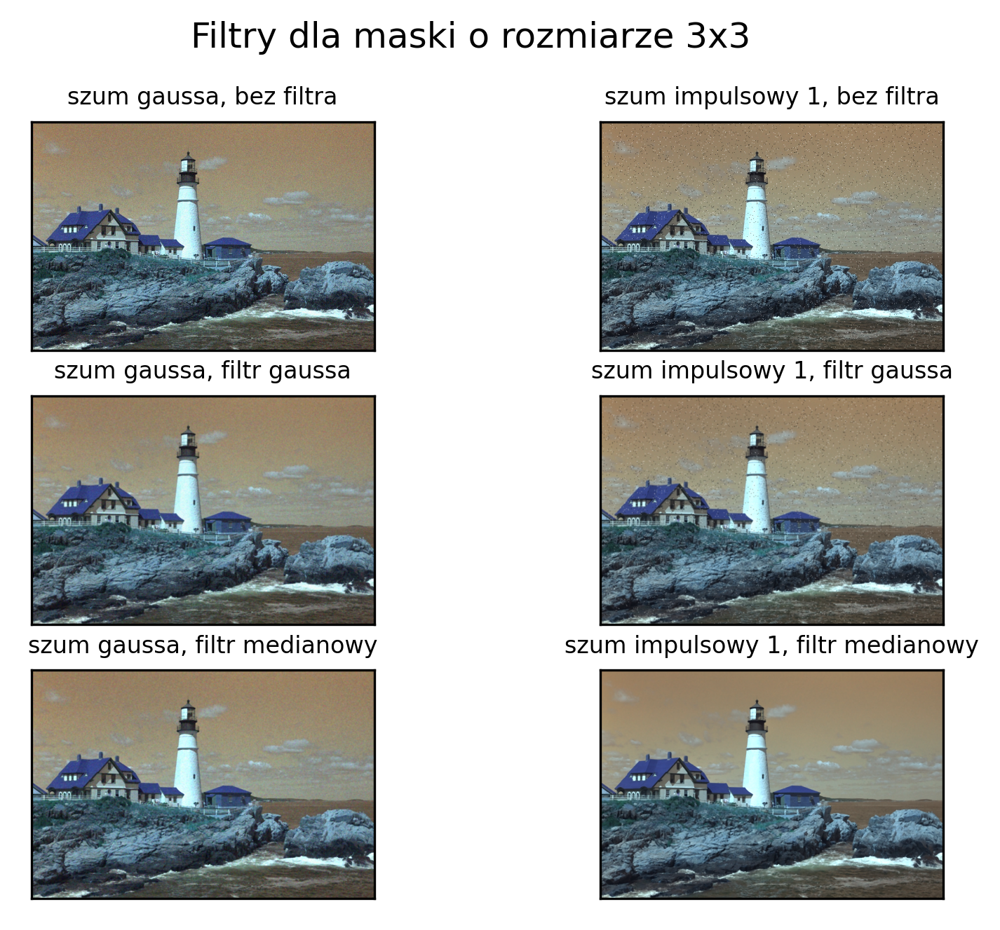

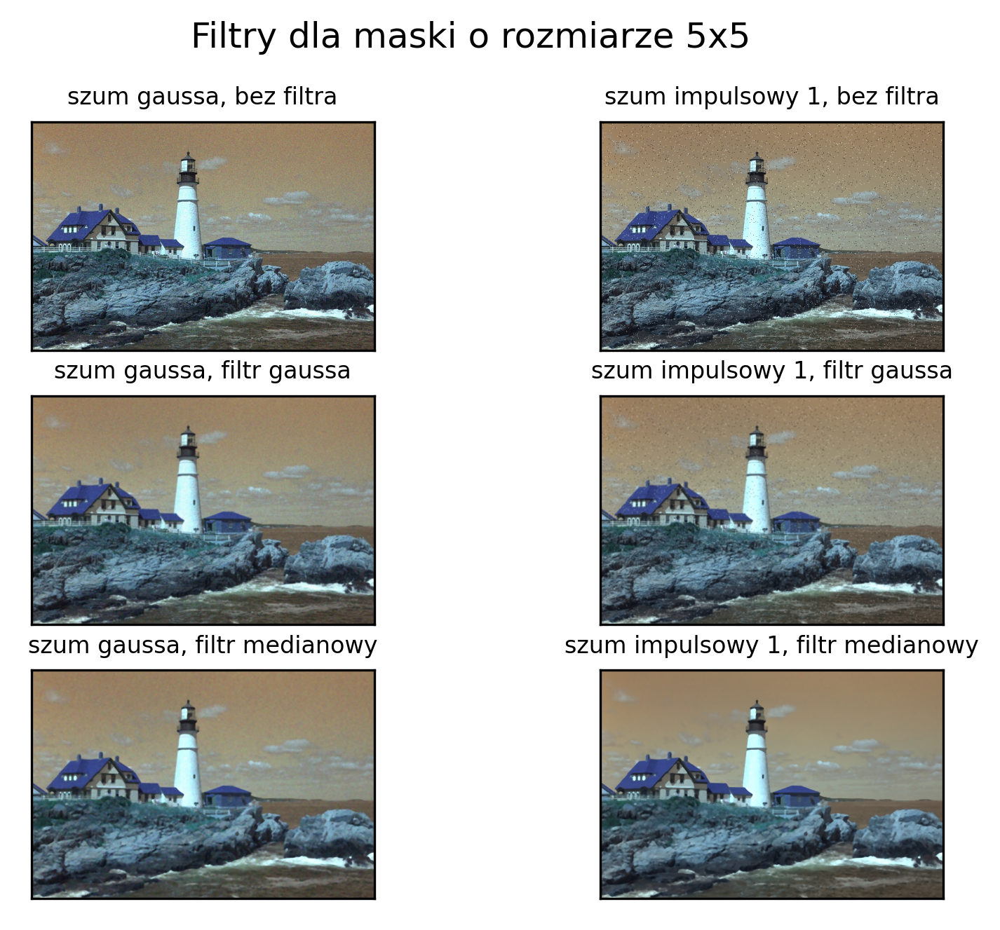

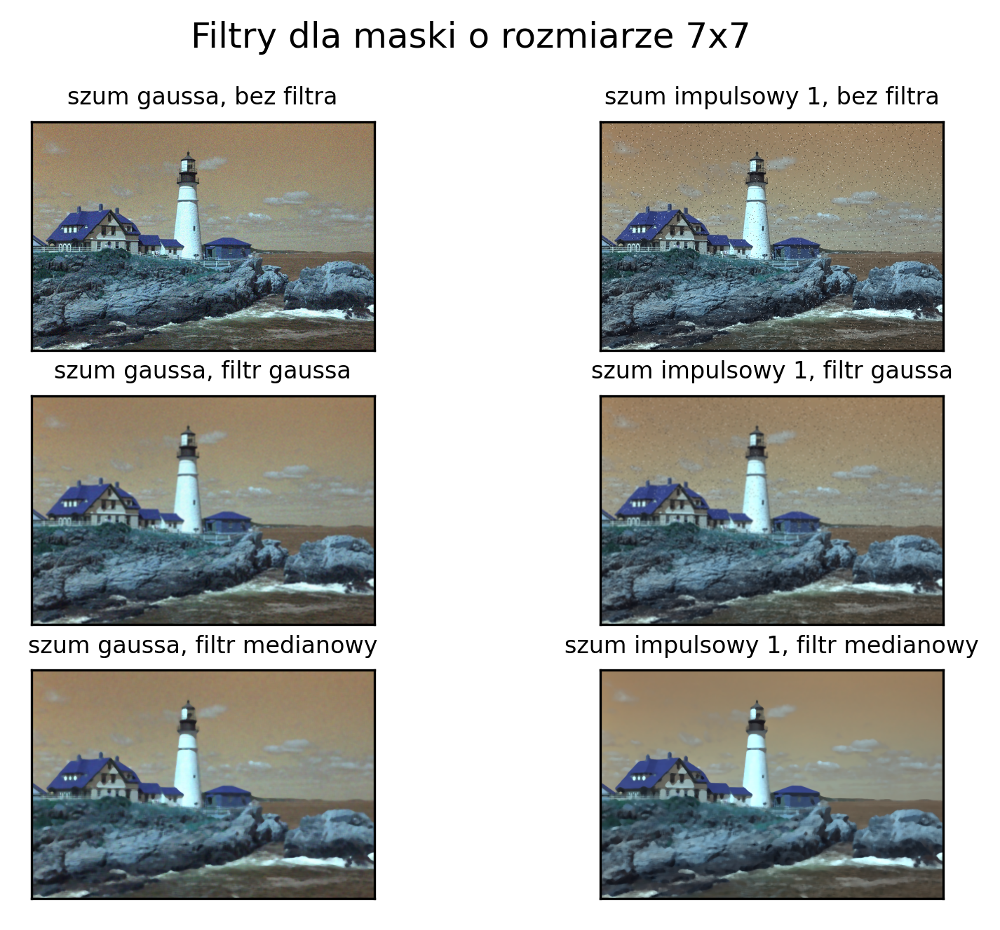

rodzaj szumu | filtr | rozmiar maski | PSNR
-------------|-------|---------------|-----
szum gaussa|filtr gaussa|3|28.66190057943669
szum impulsowy 1|filtr medianowy|3|28.60866569092461
szum impulsowy 1|filtr gaussa|3|27.39869053703748
szum gaussa|filtr medianowy|3|27.348860497497913
szum gaussa|filtr gaussa|5|27.108994762842897
szum impulsowy 1|filtr gaussa|5|26.558850329590292
szum gaussa|bez filtra|7|26.236253853941463
szum gaussa|bez filtra|5|26.236253853941463
szum gaussa|bez filtra|3|26.236253853941463
szum gaussa|filtr gaussa|7|25.710630441088842
szum impulsowy 1|filtr gaussa|7|25.460249315985017
szum impulsowy 1|filtr medianowy|5|25.245995556490918
szum gaussa|filtr medianowy|5|24.992358523856787
szum impulsowy 1|filtr medianowy|7|24.130047286654207
szum gaussa|filtr medianowy|7|24.01827748802768
szum impulsowy 1|bez filtra|7|22.62931267104145
szum impulsowy 1|bez filtra|5|22.62931267104145
szum impulsowy 1|bez filtra|3|22.62931267104145


In [95]:
images = [
    ("szum gaussa", load_img(color_n_src)),
    ("szum impulsowy 1", load_img(color_in1_src)),
    #("szum impulsowy 2", load_img(color_in2_src))
]

clean_img = load_img(color_src)

masks = [3, 5, 7]

filters = [
    ("bez filtra", lambda img, mask_size: img),
    ("filtr gaussa", lambda img, mask_size: cv2.GaussianBlur(img, (mask_size, mask_size), 0)),
    ("filtr medianowy", lambda img, mask_size: cv2.medianBlur(img, mask_size))
]

# psnr_arr = np.empty(shape=(len(images)*len(masks)*len(filters), 4))
psnr_arr = np.empty(len(images)*len(masks)*len(filters), dtype=[("szum", np.unicode_, 16), ("filtr", np.unicode_, 16), ("rozmiar maski", np.unicode_, 10), ("PSNR", np.double)])

for idx_m, mask in enumerate(masks):
    plt.suptitle(f"Filtry dla maski o rozmiarze {mask}x{mask}")
    
    for idx_y, (filter_name, filter) in enumerate(filters):
        for idx_x, (img_title, img) in enumerate(images):

            img = filter(img, mask)
            img_idx = len(images)*idx_y + idx_x
            subplot = plt.subplot(len(filters), len(images), img_idx + 1)
            # remove ticks
            subplot.set_xticks([])
            subplot.set_yticks([])
            # title based on used values
            subplot.set_title(f"{img_title}, {filter_name}", {"fontsize": "8"})
            subplot.imshow(img)

            psnr_idx = len(images)*len(filters) * idx_m + img_idx
            psnr_arr[psnr_idx] = (img_title, filter_name, mask, calcPSNR(clean_img, img))
    plt.gcf().set_dpi(300)
    plt.show()

# psnr_arr[::-1].sort(order=["rozmiar maski", "PSNR"])
psnr_arr[::-1].sort(order="PSNR")
print("rodzaj szumu | filtr | rozmiar maski | PSNR")
print("-------------|-------|---------------|-----")
for (img_type, filter, mask, psnr) in psnr_arr:
    print(f"{img_type}|{filter}|{mask}|{psnr}")


### Wyjściowe wartości posortowane po PSNR:

rodzaj szumu | filtr | rozmiar maski | PSNR
-------------|-------|---------------|-----
szum gaussa|filtr gaussa|3|28.66190057943669
szum impulsowy 1|filtr medianowy|3|28.60866569092461
szum impulsowy 1|filtr gaussa|3|27.39869053703748
szum gaussa|filtr medianowy|3|27.348860497497913
szum gaussa|filtr gaussa|5|27.108994762842897
szum impulsowy 1|filtr gaussa|5|26.558850329590292
szum gaussa|bez filtra|7|26.236253853941463
szum gaussa|bez filtra|5|26.236253853941463
szum gaussa|bez filtra|3|26.236253853941463
szum gaussa|filtr gaussa|7|25.710630441088842
szum impulsowy 1|filtr gaussa|7|25.460249315985017
szum impulsowy 1|filtr medianowy|5|25.245995556490918
szum gaussa|filtr medianowy|5|24.992358523856787
szum impulsowy 1|filtr medianowy|7|24.130047286654207
szum gaussa|filtr medianowy|7|24.01827748802768
szum impulsowy 1|bez filtra|7|22.62931267104145
szum impulsowy 1|bez filtra|5|22.62931267104145
szum impulsowy 1|bez filtra|3|22.62931267104145

### Wnioski:
>Ocenić działanie filtrów dla masek o rozmiarach: 3x3, 5x5, 7x7.

Występuje zależność: szum gaussa jest lepiej filtrowany przez filtr gaussa, a szum impulsowy przez filtr medianowy, choć to rozmiary masek grają większą rolę.

>Jaki wpływ na skuteczność filtracji i na zniekształcenie obrazu ma rozmiar maski filtru?

Im większa maska, tym bardziej obraz jest rozmyty. Nie widać na nim aż tak szumów, ale również traci on swoje detale. 

>Czy ocena subiektywna uzyskanych obrazów wynikowych, jest zgodna z PSNR (lepsza jakość – większy PSNR)?

Nie. Bardziej podobają mi się obrazy z pewnym szumem, na których jednak mogę rozpoznać jakieś detale od obrazów wygładzonych, na których brak jest szczegółów.

## Zadanie 2.

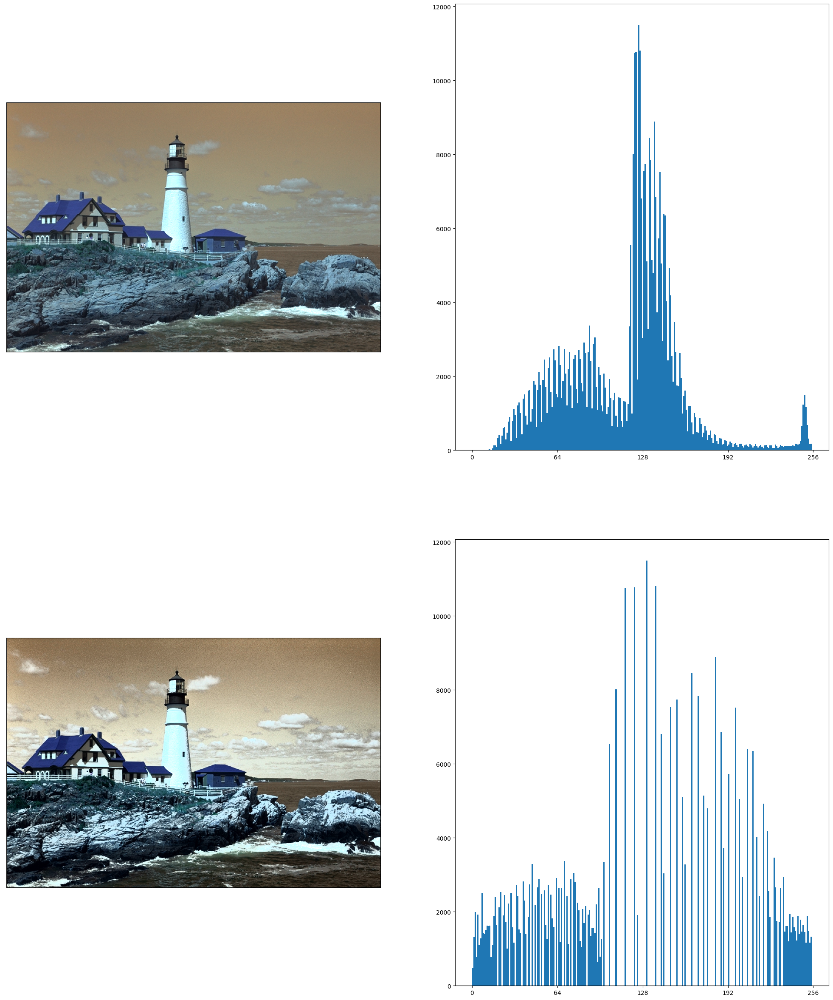

In [111]:
clean_ycbcr = cv2.cvtColor(clean_img, cv2.COLOR_BGR2YCrCb)

processed_img_ycbcr = clean_ycbcr.copy()
processed_img_ycbcr[..., 0] = cv2.equalizeHist(processed_img_ycbcr[..., 0])
processed_img = cv2.cvtColor(processed_img_ycbcr, cv2.COLOR_YCrCb2BGR)

fig, axs = plt.subplots(2, 2, figsize=(25, 30))

# left upper corner
axs[0][0].imshow(clean_img)
# remove ticks
axs[0][0].set_xticks([])
axs[0][0].set_yticks([])

# left bottom corner
axs[1][0].imshow(processed_img)
# remove ticks
axs[1][0].set_xticks([])
axs[1][0].set_yticks([])

axs[0][1].set_xticks(np.arange(0, 257, 64))
axs[0][1].hist(clean_ycbcr[..., 0].ravel(), bins=256, range=(0, 255))

axs[1][1].set_xticks(np.arange(0, 257, 64))
axs[1][1].hist(processed_img_ycbcr[..., 0].ravel(), bins=256, range=(0, 255))

plt.show()

### Wnioski
 
>Porównać uzyskane obrazy i ich histogramy (w szczególności: histogram dla składowej, dla której wykonano operację wyrównywania histogramu).

Histogram po wyrównaniu jest bardziej "rozciągnięty" na całość swojego zakresu, a w oryginalnym łatwo zauważyć konkretne zakresy o większej częstotliwości pojawiania się wyników.

>Czy obraz po wyrównaniu histogramu jest subiektywnie lepszej jakości? 

Nie, jest gorszej jakości przez nienaturalnie dużą jasność (dużo białego, razi w oczy).



## Zadanie 3.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


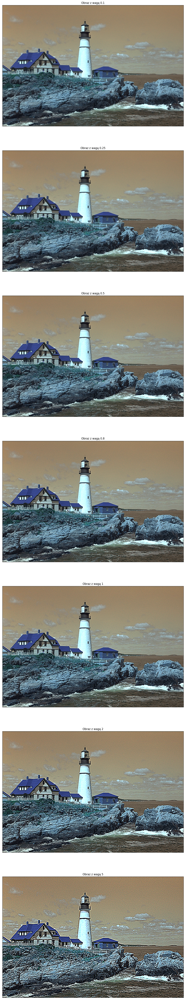

In [127]:
base_img = clean_img / 255.0

laplace_img = cv2.Laplacian(cv2.GaussianBlur(base_img, (3, 3), 0), cv2.CV_64F)

coeffs = [0.1, 0.25, 0.5, 0.8, 1, 2, 5]


fig, axs = plt.subplots(len(coeffs), 1, figsize=(50, 80))

for idx, coeff in enumerate(coeffs):
    weighted_img = cv2.addWeighted(base_img, 1, laplace_img, -coeff, 0)
    axs[idx].set_xticks([])
    axs[idx].set_yticks([])
    axs[idx].set_title(f"Obraz z wagą {coeff}")
    axs[idx].imshow(weighted_img)

### Wnioski:
>Jaki jest wpływ wagi składowej wysokoczęstotliwościowej na postać obrazu wynikowego?

Im wyższa waga, tym bardziej obraz się wyostrza i wyraźniej widać wszystkie jego krawędzie.
 
>Dla jakich wartości tej wagi uzyskuje się dobre, przyjemne dla oka wyniki?

Dla wartośći ułamkowych. Najlepiej coś w okolicy 0.25 - 0.5, choć trochę mniej czy więcej też nie kłuje. Natomist użycie wag większych od 1 znacząco wpływa na nieprzyjemną ostrość obrazu.
 